# Lesson 3: Latent Space Rules Everything Around Me

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/jonathandinu/programming-generative-ai/blob/main/notebooks/03-latent-space-vae.ipynb) [![GitHub Repo stars](https://img.shields.io/github/stars/jonathandinu/programming-generative-ai?style=social)](https://github.com/jonathandinu/programming-generative-ai)

> Colab for interactive execution in your browser (no setup) and repository for notebook index and additional resources (slides, etc.)

## 3.4 Working with Images in Python

In [1]:
# install dependencies for cloud notebook environments, i.e. Google Colab
%pip install -U diffusers["torch"] torch torchvision matplotlib scikit-image

INFO: pip is looking at multiple versions of torchvision to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 797.1/797.1 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 106.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 86.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 54.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 18.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 37.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 18.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.2/1

In [2]:
import torch
from torch import nn
import torch.nn.functional as F
import torchvision as tv
from torchvision.transforms import v2
from diffusers import utils
from PIL import Image

import matplotlib.pyplot as plt

# default device boilerplate
device = (
    "cuda" # Device for NVIDIA or AMD GPUs
    if torch.cuda.is_available()
    else "mps" # Device for Apple Silicon (Metal Performance Shaders)
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {device} device")

Using cuda device


In [3]:
fmnist = tv.datasets.FashionMNIST(
    "./data", train=True, download=True, transform=tv.transforms.ToTensor()
)

100%|██████████| 26421880/26421880 [00:02<00:00, 9814352.12it/s] 


Extracting ./data/FashionMNIST/raw/train-images-idx3-ubyte.gz to ./data/FashionMNIST/raw



100%|██████████| 29515/29515 [00:00<00:00, 177170.26it/s]


Extracting ./data/FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./data/FashionMNIST/raw



100%|██████████| 4422102/4422102 [00:01<00:00, 3221876.97it/s]


Extracting ./data/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./data/FashionMNIST/raw



100%|██████████| 5148/5148 [00:00<00:00, 8102167.73it/s]

Extracting ./data/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/FashionMNIST/raw



In [4]:
print(fmnist.data.shape)

torch.Size([60000, 28, 28])


In [5]:
fmnist

Dataset FashionMNIST
    Number of datapoints: 60000
    Root location: ./data
    Split: Train
    StandardTransform
Transform: ToTensor()

In [6]:
fmnist.data[0]

tensor([[  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
           0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0],
        [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
           0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0],
        [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
           0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0],
        [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   1,   0,
           0,  13,  73,   0,   0,   1,   4,   0,   0,   0,   0,   1,   1,   0],
        [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   3,   0,
          36, 136, 127,  62,  54,   0,   0,   0,   1,   3,   4,   0,   0,   3],
        [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   6,   0,
         102, 204, 176, 134, 144, 123,  23,   0,   0,   0,   0,  12,  10,   0],
        [  0,   0,   0,   0,   0,   0,   0,   

In [7]:
Image.fromarray(fmnist.data[0].numpy())

In [8]:
fmnist.data[0].numpy().shape

(28, 28)

In [9]:
# download image with wget
!wget https://raw.githubusercontent.com/jonathandinu/programming-generative-ai/refs/heads/main/images/cat_in_hat.png

--2024-12-15 20:52:33--  https://raw.githubusercontent.com/jonathandinu/programming-generative-ai/refs/heads/main/images/cat_in_hat.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1444925 (1.4M) [image/png]
Saving to: ‘cat_in_hat.png’

cat_in_hat.png      100%[===================>]   1.38M  --.-KB/s    in 0.008s  

2024-12-15 20:52:34 (179 MB/s) - ‘cat_in_hat.png’ saved [1444925/1444925]



[image source](https://publicdomainreview.org/collection/kittens-and-cats-a-first-reader-1911-cats-and-captions-before-the-internet-age/)

In [10]:
img = Image.open('cat_in_hat.png')

In [11]:
import numpy as np

In [12]:
np.array(img)[0][0]

array([247, 233, 206], dtype=uint8)

## 3.5 The FashionMNIST Dataset

* [Original repo](https://github.com/zalandoresearch/fashion-mnist)
* [PyTorch wrapper](https://pytorch.org/vision/0.18/generated/torchvision.datasets.FashionMNIST.html)

In [13]:
batch = 10
imshow_size = 256

grid = v2.functional.resize(fmnist.data[:batch], imshow_size, interpolation=v2.InterpolationMode.NEAREST)

In [14]:
grid.shape

torch.Size([10, 256, 256])

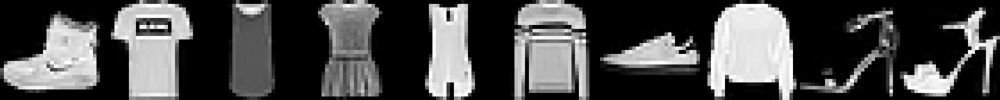

In [15]:
utils.make_image_grid([Image.fromarray(img) for img in grid.numpy()], 1, 10)

In [16]:
fmnist.classes

['T-shirt/top',
 'Trouser',
 'Pullover',
 'Dress',
 'Coat',
 'Sandal',
 'Shirt',
 'Sneaker',
 'Bag',
 'Ankle boot']

## 3.6 Convolutional Neural Networks in PyTorch

In [17]:
# LeNet: https://en.wikipedia.org/wiki/LeNet#:~:text=LeNet%20is%20a%20series%20of,%2D5%20architecture%20(detailed)
class LeNet(nn.Module):
  def __init__(self):
    super(LeNet, self).__init__()

    self.conv1 = nn.Conv2d(in_channels=1, out_channels=6, kernel_size=5)
    self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
    self.conv2 = nn.Conv2d(6, 16, 5)

    self.fc1 = nn.Linear(16 * 5 * 5, 120)
    self.fc2 = nn.Linear(120, 84)
    self.fc3 = nn.Linear(84, 10)

  def forward(self, x):
    # convolutional layers of network
    x = self.pool(F.relu(self.conv1(x)))
    x = self.pool(F.relu(self.conv2(x)))

    # fully connected portion of network
    x = torch.flatten(x, 1)
    x = F.relu(self.fc1(x))
    x = F.relu(self.fc2(x))

    # output
    x = self.fc3(x)

    return x

In [18]:
net = LeNet()

input = torch.randn(1, 1, 32, 32)
net(input)

tensor([[-0.1989,  0.0312, -0.0447,  0.0758,  0.0160,  0.0390,  0.1561, -0.1331,
          0.0200, -0.0629]], grad_fn=<AddmmBackward0>)

## 3.9 Defining an Autoencoder with PyTorch

In [19]:
class Autoencoder(nn.Module):
  def __init__(self, latent_dim, shape):
    super(Autoencoder, self).__init__()

    self.encoder = nn.Sequential(
        nn.Linear(shape, latent_dim),
        nn.ReLU()
    )

    self.decoder = nn.Sequential(
        nn.Linear(latent_dim, shape),
        nn.ReLU()
    )

  def forward(self, x):
    latent_vector = self.encoder(x)
    return self.decoder(latent_vector)

## 3.10 Setting Up a Training Loop

In [20]:
import torch.optim as optim

net = Autoencoder(64, 28 * 28)
net.to(device)

# use mean squared error loss since pixel values are continuous
criterion = nn.MSELoss()

# use PyTorch's built-in minibatch SGD with momentum
optimizer = optim.SGD(net.parameters(), lr=0.2, momentum=0.9)
batch_size = 8

# turn dataset into an iterable DataLoader for training loop
loader = torch.utils.data.DataLoader(
    fmnist, batch_size=batch_size, shuffle=True, generator=torch.Generator()
)

for epoch in range(2):
  running_loss = 0.0

  for i, data in enumerate(loader, 0):
    inputs = data[0].to(device)

    inputs = inputs.reshape(batch_size, 28 * 28)

    optimizer.zero_grad()

    # forward + backward + optimize
    outputs = net(inputs)
    loss = criterion(outputs, inputs)
    loss.backward()
    optimizer.step()

    running_loss += loss.item()
    if i % 1000 == 999:
      print(f"[{epoch}, {i + 1:5d}] loss: {running_loss / 1000:.3f}")
      running_loss = 0.0

[0,  1000] loss: 0.064
[0,  2000] loss: 0.042
[0,  3000] loss: 0.036
[0,  4000] loss: 0.034
[0,  5000] loss: 0.032
[0,  6000] loss: 0.031
[0,  7000] loss: 0.029
[1,  1000] loss: 0.028
[1,  2000] loss: 0.028
[1,  3000] loss: 0.027
[1,  4000] loss: 0.026
[1,  5000] loss: 0.025
[1,  6000] loss: 0.025
[1,  7000] loss: 0.025


## 3.11 Inference with an Autoencoder

In [21]:
rand_vec = torch.rand(64).to(device)
sample = net.decoder(rand_vec).reshape(28, 28).cpu().detach().numpy()

In [22]:
sample

array([[1.58692271e-01, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        2.18825787e-01, 2.27386519e-01, 0.00000000e+00, 0.00000000e+00,
        3.89997251e-02, 0.00000000e+00, 0.00000000e+00, 1.31601170e-01,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        5.08873500e-02, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        6.93628490e-01, 2.64778510e-02, 3.30943048e-01, 2.25913629e-01,
        2.48136461e-01, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        6.66539669e-02, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000

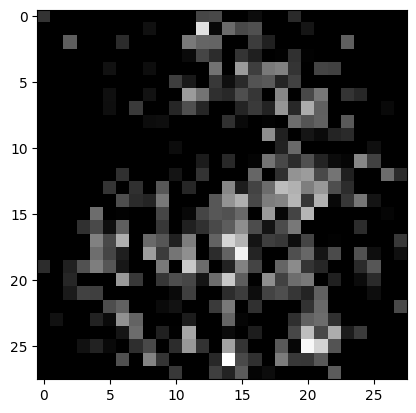

In [23]:
plt.imshow(sample, cmap="gray")

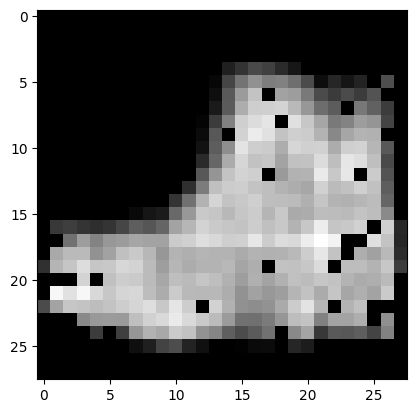

In [24]:
img = (fmnist.data[0] / 255).reshape(1, 28 * 28)
latent = net.encoder(img.to(device))
plt.imshow(net.decoder(latent).reshape(1, 28, 28).detach().cpu().numpy()[0], cmap="gray");

## 3.15 Transforming an Autoencoder into a VAE

In [25]:
class VAE(nn.Module):
    def __init__(self, latent_dim, shape):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels=1, out_channels=8, kernel_size=5, stride=1),
            nn.ReLU(),
            nn.Conv2d(in_channels=8, out_channels=16, kernel_size=5, stride=1),
            nn.ReLU(),
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=5, stride=1),
            nn.ReLU(),
            nn.Flatten()
        )

        self.decoder = nn.Sequential(
            nn.Unflatten(-1, (32, 16, 16)),
            nn.ConvTranspose2d(32, 16, kernel_size=5, stride=1),
            nn.ReLU(),
            nn.ConvTranspose2d(16, 8, kernel_size=5, stride=1),
            nn.ReLU(),
            nn.ConvTranspose2d(8, 1, kernel_size=5, stride=1),
            nn.Sigmoid()
        )

        self.mu = nn.Linear(8192, latent_dim)
        self.logvar = nn.Linear(8192, latent_dim)
        self.fc = nn.Linear(latent_dim, 8192)

    def encode(self, x):
      h = self.encoder(x)
      return self.mu(h), self.logvar(h)

    def decode(self, z):
      z = self.fc(z)
      return self.decoder(z)

    def reparameterize(self, mu, logvar):
      std = torch.exp(0.5 * logvar)
      eps = torch.randn_like(std)
      return mu + eps * std

    def forward(self, x):
      mu, logvar = self.encode(x)
      z = self.reparameterize(mu, logvar)
      return self.decode(z), mu, logvar

## 3.16 Training a VAE with PyTorch

In [26]:
batch_size = 8

# turn dataset into an iterable DataLoader for training loop
loader = torch.utils.data.DataLoader(
    fmnist, batch_size=batch_size, shuffle=True, generator=torch.Generator()
)

In [27]:
datum = next(iter(loader))
datum[0].shape

torch.Size([8, 1, 28, 28])

In [28]:
net = VAE(64, 28 * 28)

In [29]:
# just the encoder (before the mean and variance projection)
net.encoder(datum[0]).shape

torch.Size([8, 8192])

In [30]:
# latent vector of mean
net.mu(net.encoder(datum[0])).shape

torch.Size([8, 64])

In [31]:
# full forward pass (encode + decode)
net(datum[0])[0].shape

torch.Size([8, 1, 28, 28])

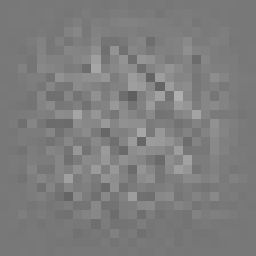

In [32]:
recon = net(datum[0])[0][0].reshape(1, 28, 28)
v2.functional.to_pil_image(recon).resize((256, 256), resample=Image.Resampling.NEAREST)

[9,  7500] loss: 223.341


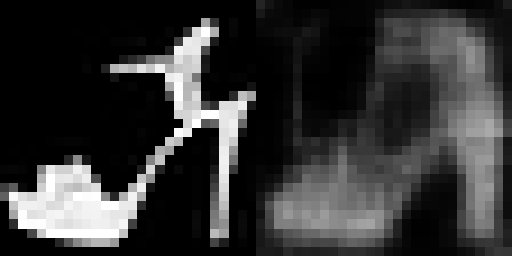

We done!


In [33]:
import torch.optim as optim
from IPython.display import display, clear_output

net = VAE(16, 28 * 28)
net.to(device)

optimizer = optim.Adam(net.parameters(), lr=2e-5)

# sample image to evaluate learning progress
target = fmnist[9][0].reshape(1, 1, 28, 28).to(device)

def loss_fn(reconstruction, x, mu, logvar):
    reconstruction = reconstruction.reshape(batch_size, 28 * 28)
    x = x.reshape(batch_size, 28 * 28)

    mse = F.mse_loss(reconstruction, x, reduction='sum')
    kl = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    return mse + kl

# helper function to visualize images
def show_im(x, size=128):
  pil_img = v2.functional.to_pil_image(x)
  return pil_img.resize((size, size), resample=Image.Resampling.NEAREST)

# actual training loop
for epoch in range(10):
    running_loss = 0.0
    for i, data in enumerate(loader, 0):
        # we just need the inputs and can discard labels
        inputs = data[0].to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward
        recon, mu, logvar = net(inputs)

        # compute loss
        loss = loss_fn(recon, inputs, mu, logvar)

        # backward + optimize
        loss.backward()
        optimizer.step()

        # print loss progress every 500 minibatches
        running_loss += loss.item()
        if i % 500 == 499:
            clear_output(wait=True)
            print(f"[{epoch}, {i + 1:5d}] loss: {running_loss / 500:.3f}")
            running_loss = 0.0

            # visualize reconstruction learning progress
            recon = net(target)[0][0].reshape(1, 28, 28)
            compare = [show_im(target[0], 256), show_im(recon, 256)]
            display(utils.make_image_grid(compare, rows=1, cols=2))

print("We done!")

## 3.17 Exploring Latent Space

In [34]:
rand_latent = torch.randn(16).to(device)
rand_latent

tensor([-0.0682,  0.0655, -1.2474, -0.4785, -0.7686, -1.2251, -1.4043,  1.7611,
        -0.2991, -1.2342, -0.0398,  0.1320, -0.9002,  1.4368, -0.6284, -0.7659],
       device='cuda:0')

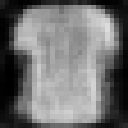

In [35]:
show_im(net.decode(rand_latent))

In [36]:
def get_latents(net, x):
  mu, logvar = net.encode(x.to(device))
  z = net.reparameterize(mu, logvar)
  return z

In [37]:
get_latents(net, datum[0]).shape

torch.Size([8, 16])

In [38]:
perm = torch.randperm(len(fmnist))[:1000]

In [39]:
sample_imgs, sample_labels = fmnist.data[perm] / 255, fmnist.targets[perm]

latent_vectors = get_latents(net, sample_imgs.reshape(-1, 1, 28, 28))
print(latent_vectors.shape)

torch.Size([1000, 16])


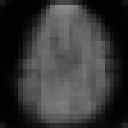

In [40]:
show_im(net.decode(latent_vectors.mean(0)))

In [41]:
fmnist.classes

['T-shirt/top',
 'Trouser',
 'Pullover',
 'Dress',
 'Coat',
 'Sandal',
 'Shirt',
 'Sneaker',
 'Bag',
 'Ankle boot']

In [42]:
from torch.utils.tensorboard import SummaryWriter

writer = SummaryWriter()

In [43]:
sample_imgs.shape

torch.Size([1000, 28, 28])

In [44]:
writer.add_embedding(latent_vectors,
                    metadata=[fmnist.classes[l] for l in sample_labels],
                    label_img=sample_imgs.unsqueeze(1)
                  )

In [45]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

## 3.18 Latent Space Interpolation and Attribute Vectors

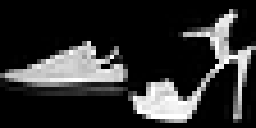

In [46]:
sneaker = fmnist[6][0]
sandal = fmnist[9][0]

utils.make_image_grid([show_im(sneaker), show_im(sandal)], rows=1, cols=2)

In [47]:
sneaker_latent = get_latents(net, sneaker.reshape(1, 1, 28, 28))
sandal_latent = get_latents(net, sandal.reshape(1, 1, 28, 28))

In [48]:
sneaker_latent

tensor([[ 0.7905,  0.2169,  1.0435,  1.4319,  0.1998, -0.0215,  2.2914,  0.1117,
         -0.7166, -1.0499,  1.1806,  0.4063,  2.4925, -0.4904,  0.3319, -1.0297]],
       device='cuda:0', grad_fn=<AddBackward0>)

In [49]:
linear_intp = lambda frac, x1, x2: (1 - frac) * x1 + frac * x2

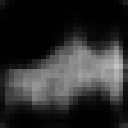

In [50]:
intp_latent = linear_intp(0.5, sneaker_latent, sandal_latent)[0]

show_im(net.decode(intp_latent))

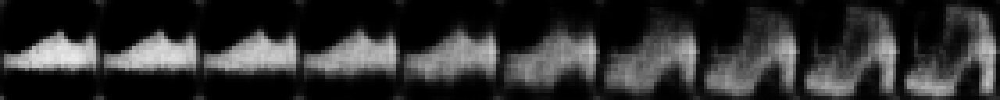

In [51]:
interpolations = [linear_intp(t, sneaker_latent, sandal_latent)[0] for t in np.linspace(0, 1, 10) ]

utils.make_image_grid([show_im(net.decode(intp)) for intp in interpolations], rows=1, cols=10)

In [52]:
# attribute vectors
print(fmnist.class_to_idx)
boots = fmnist.data[fmnist.targets == 9] / 255
not_boots = fmnist.data[fmnist.targets != 9] / 255

{'T-shirt/top': 0, 'Trouser': 1, 'Pullover': 2, 'Dress': 3, 'Coat': 4, 'Sandal': 5, 'Shirt': 6, 'Sneaker': 7, 'Bag': 8, 'Ankle boot': 9}


In [53]:
avg_boot = get_latents(net, boots.reshape(-1, 1, 28, 28)).mean(dim=0)

In [54]:
avg_not_boot = get_latents(net, not_boots.reshape(-1, 1, 28, 28)).mean(dim=0)

In [55]:
boot_vector = avg_boot - avg_not_boot

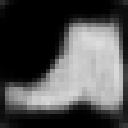

In [56]:
show_im(net.decode(boot_vector))

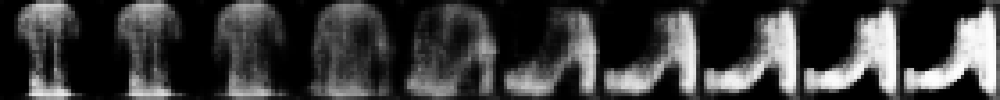

In [57]:
interpolations = [(sandal_latent + t * boot_vector)[0] for t in np.linspace(-3, 3, 10) ]

utils.make_image_grid([show_im(net.decode(intp)) for intp in interpolations], rows=1, cols=10)

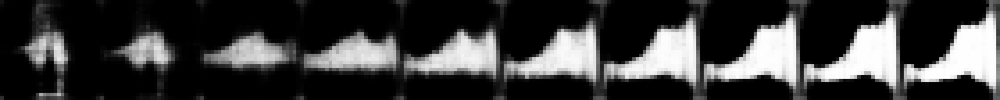

In [58]:
interpolations = [(sneaker_latent + t * boot_vector)[0] for t in np.linspace(-2, 4, 10) ]

utils.make_image_grid([show_im(net.decode(intp)) for intp in interpolations], rows=1, cols=10)

In [59]:
placeholder = torch.cat((torch.ones(0, 100, 100), torch.zeros(1, 100, 100), torch.zeros(1, 100, 100)))

writer = SummaryWriter()

latents = torch.cat((latent_vectors, boot_vector.reshape(1, -1)))
classes = [fmnist.classes[l] for l in sample_labels] + ['Boot Vector']
images = torch.cat((sample_imgs.unsqueeze(1), torch.ones(1, 1, 28, 28)))

writer.add_embedding(latents, metadata=classes, label_img=images)

In [60]:
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 5956), started 0:00:01 ago. (Use '!kill 5956' to kill it.)

<IPython.core.display.Javascript object>

## Appendix

In [61]:
# version of Python of the current Jupyter kernel
import sys, datetime

print(f"Current notebook Python version: {sys.version}")
print(f"Notebook last executed: {datetime.datetime.now()}")

Current notebook Python version: 3.10.12 (main, Nov  6 2024, 20:22:13) [GCC 11.4.0]
Notebook last executed: 2024-12-15 20:59:15.422732


In [62]:
# package versions when this notebook was last run in Colab (and committed)
!pip freeze

absl-py==1.4.0
accelerate==1.1.1
aiohappyeyeballs==2.4.4
aiohttp==3.11.10
aiosignal==1.3.1
alabaster==1.0.0
albucore==0.0.19
albumentations==1.4.20
altair==5.5.0
annotated-types==0.7.0
anyio==3.7.1
argon2-cffi==23.1.0
argon2-cffi-bindings==21.2.0
array_record==0.5.1
arviz==0.20.0
astropy==6.1.7
astropy-iers-data==0.2024.12.9.0.36.21
astunparse==1.6.3
async-timeout==4.0.3
atpublic==4.1.0
attrs==24.2.0
audioread==3.0.1
autograd==1.7.0
babel==2.16.0
backcall==0.2.0
beautifulsoup4==4.12.3
bigframes==1.27.0
bigquery-magics==0.4.0
bleach==6.2.0
blinker==1.9.0
blis==0.7.11
blosc2==2.7.1
bokeh==3.6.2
Bottleneck==1.4.2
bqplot==0.12.43
branca==0.8.0
CacheControl==0.14.1
cachetools==5.5.0
catalogue==2.0.10
certifi==2024.8.30
cffi==1.17.1
chardet==5.2.0
charset-normalizer==3.4.0
chex==0.1.87
clarabel==0.9.0
click==8.1.7
cloudpathlib==0.20.0
cloudpickle==3.1.0
cmake==3.30.5
cmdstanpy==1.2.4
colorcet==3.1.0
colorlover==0.3.0
colour==0.1.5
community==1.0.0b1
confection==0.1.5
cons==0.4.6
contourpy==1